In [1]:
%reset -f
%reload_ext autoreload
%autoreload 2
%matplotlib inline

## Camera Operations

In [2]:
# from camera import CameraHandler

In [3]:
# cam = CameraHandler(resolution=(640,480))

In [4]:
# cam.capture()

In [5]:
# cam.pil_image

In [6]:
# cam.save('./data/test.png')

## Sticky plate

In [7]:
from stickyplate import StickyPlate
from PIL import Image

In [8]:
sp = StickyPlate('/home/pi/Desktop/debugging/herentVAL2_NA_w23_4050x3040.png', './calib/')

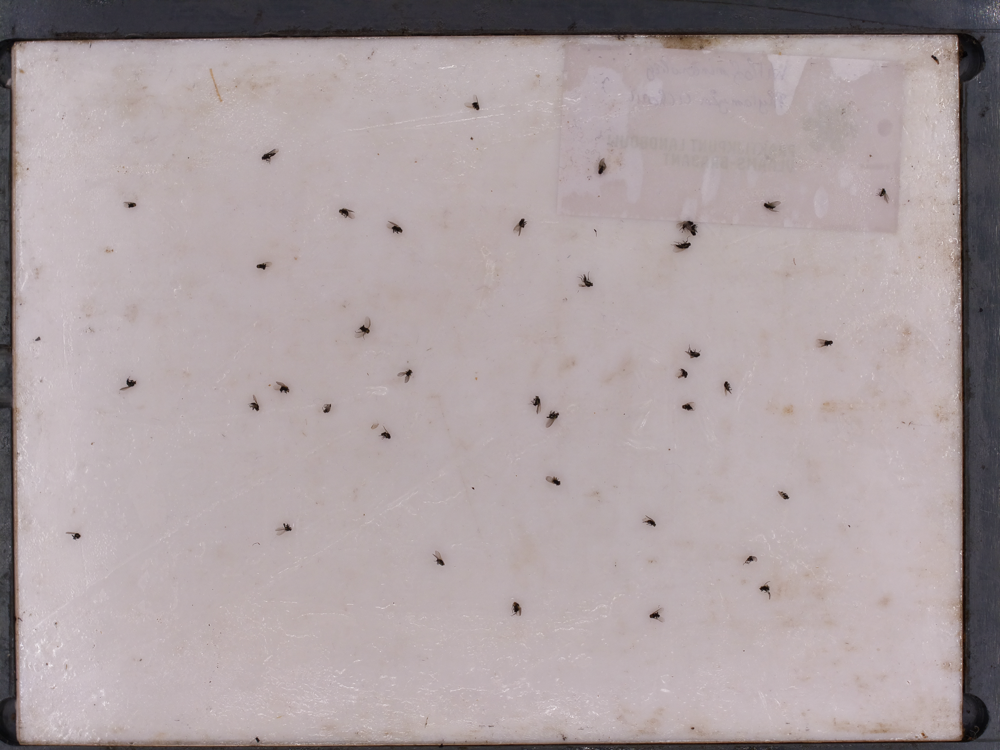

In [9]:
Image.fromarray(sp.image)

## Undistorting

In [10]:
sp.undistort(inplace=True, verbose=True)


UNDISTORTING : herentVAL2_NA_w23_4050x3040


In [11]:
# Image.fromarray(sp.image)

## Cropping

In [12]:
sp.crop_image()#crop_pxls_top=100, crop_pxls_left=10)

Original image shape: (2994, 3978, 3)
New image shape: (2714, 3648, 3)


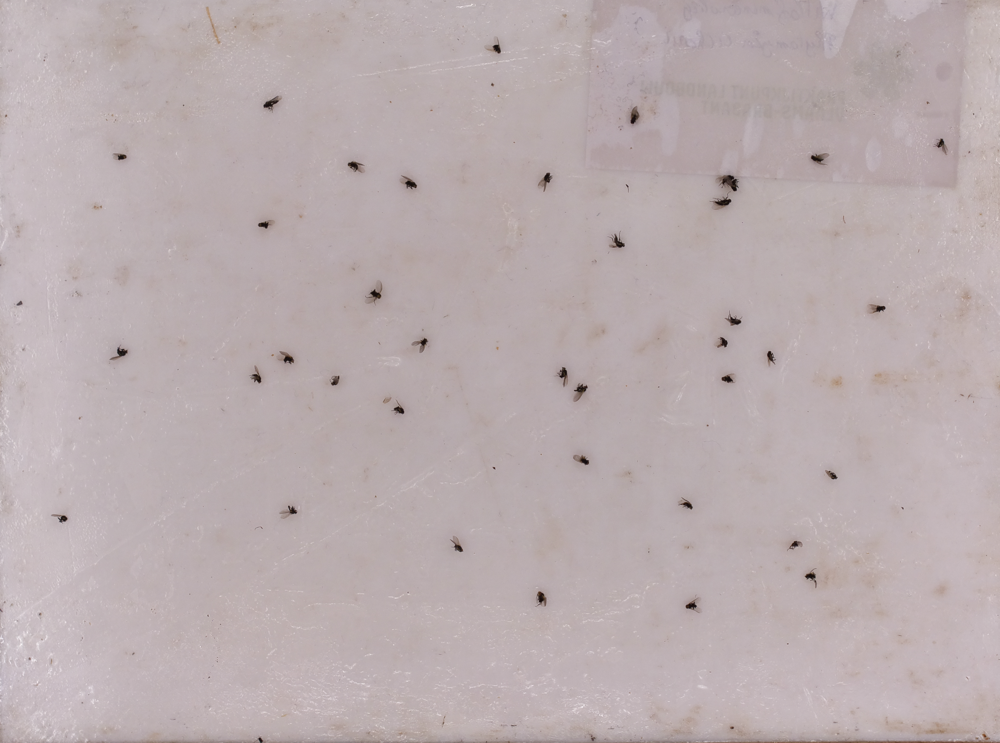

In [13]:
Image.fromarray(sp.image)

## Thresholing

In [14]:
sp.threshold_image()#bnw_threshold=127)

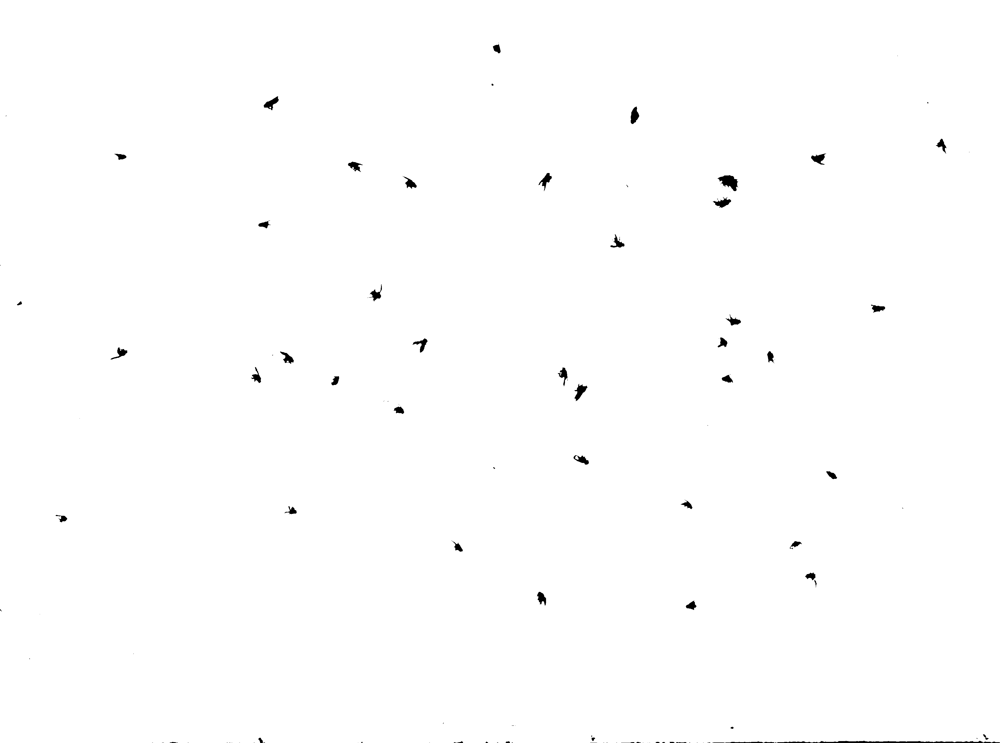

In [15]:
sp.pil_thresholded

## Detecting Insects

In [16]:
sp.detect_objects(min_obj_area=5, max_obj_area=7000, nms_threshold=0.08, insect_img_dim=150)

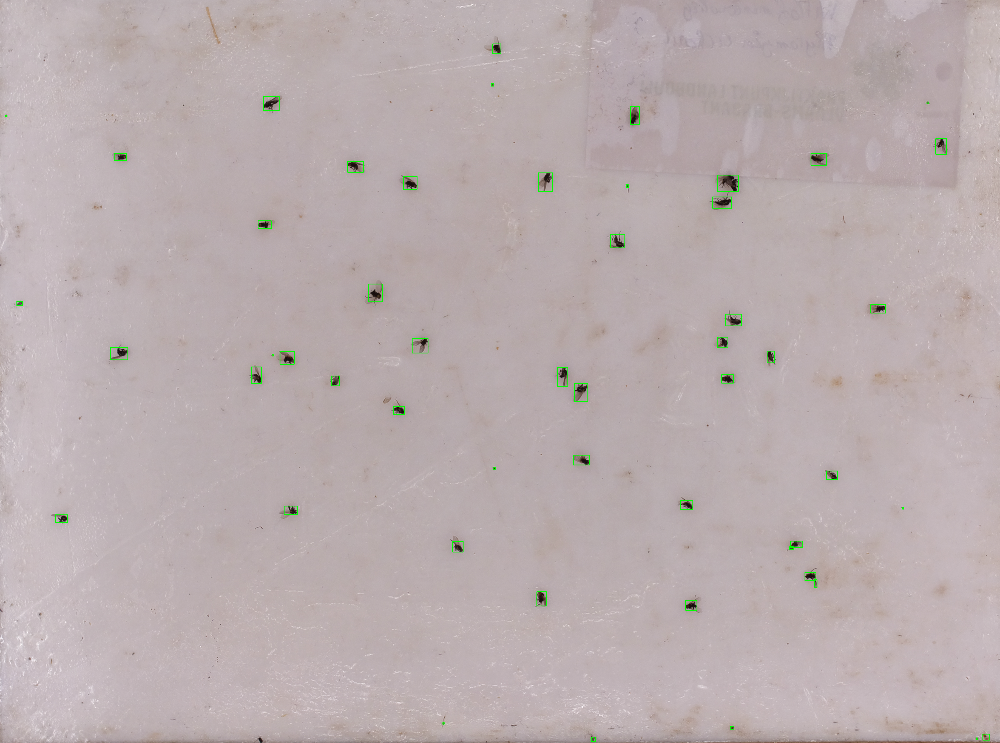

In [17]:
Image.fromarray(sp.image_bboxes)

In [18]:
sp.save_detections(savepath='/home/pi/Desktop/debugging/detections/')

Saving detections..: 100%|██████████████████████| 57/57 [00:01<00:00, 31.33it/s]


## AI operations

In [19]:
from detections import InsectImgDataset, InsectModel, ModelDetections

In [20]:
model = InsectModel(modelname='densenet121').load()

md = ModelDetections(path='/home/pi/Desktop/debugging/detections/')
md.create_data_generator()
md.dataset = InsectImgDataset(df=md.df)
md.df['full_filename'] = md.df.filename
md.get_predictions(model)

Predicting insect classes..: 100%|██████████████| 57/57 [01:21<00:00,  1.42s/it]


In [21]:
with open("INSECTS.txt", "r") as f:
    insectoptions = f.read().split('\n')

In [22]:
import pandas as pd
df = pd.merge(md.df, sp.yolo_specs, on=['insect_idx'])

In [23]:
df.iloc[0].wmv

4.3336325

In [26]:
from utils import overlay_yolo

img = overlay_yolo(df, sp.image, insectoptions[:-2])

                                             filename insect_idx  \
0   /home/pi/Desktop/debugging/detections/herentVA...          0   
1   /home/pi/Desktop/debugging/detections/herentVA...          1   
2   /home/pi/Desktop/debugging/detections/herentVA...          2   
3   /home/pi/Desktop/debugging/detections/herentVA...          3   
4   /home/pi/Desktop/debugging/detections/herentVA...          4   
5   /home/pi/Desktop/debugging/detections/herentVA...          5   
6   /home/pi/Desktop/debugging/detections/herentVA...          6   
7   /home/pi/Desktop/debugging/detections/herentVA...          7   
8   /home/pi/Desktop/debugging/detections/herentVA...          8   
9   /home/pi/Desktop/debugging/detections/herentVA...          9   
10  /home/pi/Desktop/debugging/detections/herentVA...         10   
11  /home/pi/Desktop/debugging/detections/herentVA...         11   
12  /home/pi/Desktop/debugging/detections/herentVA...         12   
13  /home/pi/Desktop/debugging/detections/herent

Overlaying bboxes with predictions..: 100%|█████| 57/57 [00:00<00:00, 88.48it/s]


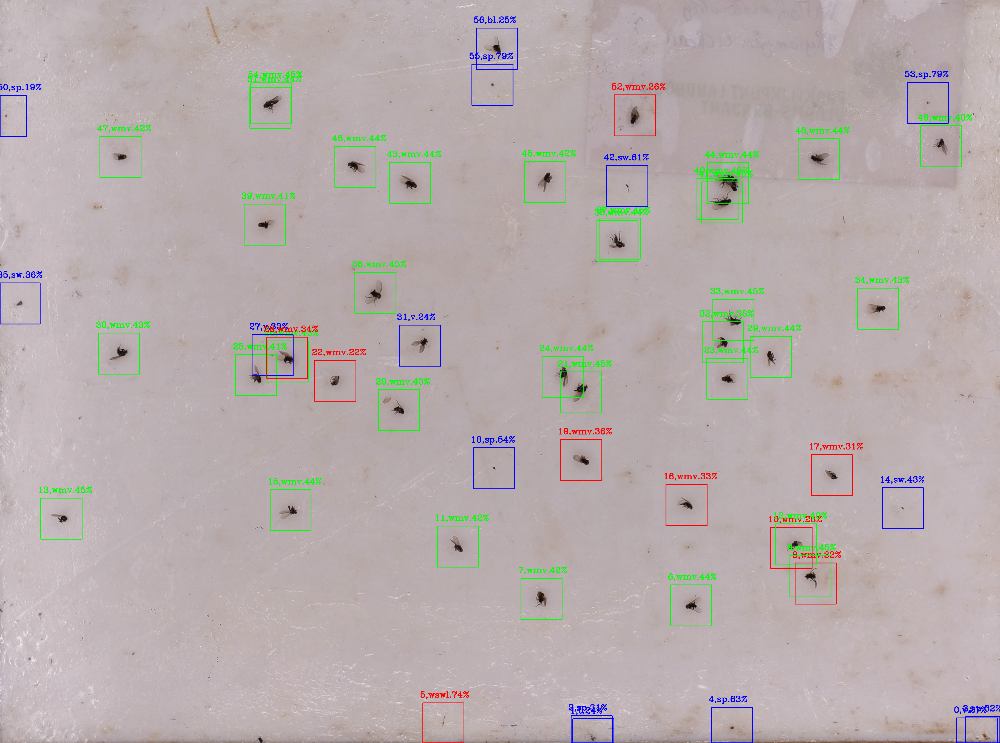

In [27]:
Image.fromarray(img)